# Pothole Detection using Computer Vision


### Environment Setup

#### Install tensorflow v1.14

In [1]:
# check tensorflow version
import tensorflow as tf
print(tf.__version__)

2.6.0


In [2]:
# Colab default version is now 2.6.0, so uninstall it and install v1.14

%tensorflow_version 2.x
!pip uninstall -y tensorflow tensorboard tensorflow-estimator tensorboard-plugin-wit
!pip install tensorflow-gpu==1.14.0 tensorboard==1.14.0 tensorflow-estimator==1.14.0 

Found existing installation: tensorflow 2.6.0
Uninstalling tensorflow-2.6.0:
  Successfully uninstalled tensorflow-2.6.0
Found existing installation: tensorboard 2.6.0
Uninstalling tensorboard-2.6.0:
  Successfully uninstalled tensorboard-2.6.0
Found existing installation: tensorflow-estimator 2.6.0
Uninstalling tensorflow-estimator-2.6.0:
  Successfully uninstalled tensorflow-estimator-2.6.0
Found existing installation: tensorboard-plugin-wit 1.8.0
Uninstalling tensorboard-plugin-wit-1.8.0:
  Successfully uninstalled tensorboard-plugin-wit-1.8.0
     |████████████████████████████████| 377.1 MB 9.4 kB/s 
     |████████████████████████████████| 3.1 MB 23.3 MB/s 
     |████████████████████████████████| 488 kB 55.9 MB/s 
     |████████████████████████████████| 50 kB 6.3 MB/s 


In [2]:
# tensorflow version

import tensorflow as tf
print(tf.__version__)

1.14.0


#### Install necessary libraries

In [3]:
# install necessary libraries

!apt-get install -qq protobuf-compiler python-pil python-lxml python-tk
!pip install -q pillow lxml jupyter matplotlib cython pandas contextlib2
!pip install -q pycocotools tf_slim

Selecting previously unselected package python-bs4.
(Reading database ... 155219 files and directories currently installed.)
Preparing to unpack .../0-python-bs4_4.6.0-1_all.deb ...
Unpacking python-bs4 (4.6.0-1) ...
Selecting previously unselected package python-pkg-resources.
Preparing to unpack .../1-python-pkg-resources_39.0.1-2_all.deb ...
Unpacking python-pkg-resources (39.0.1-2) ...
Selecting previously unselected package python-chardet.
Preparing to unpack .../2-python-chardet_3.0.4-1_all.deb ...
Unpacking python-chardet (3.0.4-1) ...
Selecting previously unselected package python-six.
Preparing to unpack .../3-python-six_1.11.0-2_all.deb ...
Unpacking python-six (1.11.0-2) ...
Selecting previously unselected package python-webencodings.
Preparing to unpack .../4-python-webencodings_0.5-2_all.deb ...
Unpacking python-webencodings (0.5-2) ...
Selecting previously unselected package python-html5lib.
Preparing to unpack .../5-python-html5lib_0.999999999-1_all.deb ...
Unpacking pyt

#### Mount the drive

In [4]:
#mount google drive

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


#### Create a project folder inside the drive

In [ ]:
# create a folder 'pothole' inside My Drive and navigate to it
%cd /content/gdrive/My Drive/pothole 

/content/gdrive/My Drive/pothole


#### Clone tensorflow 1 object detection api

In [ ]:
# clone tensorflow 1 object detection api
!git clone --quiet -b r1.13.0 https://github.com/tensorflow/models.git

#### Compile protos

In [ ]:
#navigate to /content/gdrive/My Drive/pothole/models/research folder 
%cd /content/gdrive/My Drive/pothole/models/research
 
# compile protos
!protoc object_detection/protos/*.proto --python_out=.

import os
os.environ['PYTHONPATH'] += ':/content/gdrive/My Drive/pothole/models/research/:/content/gdrive/My Drive/pothole/models/research/slim/'

!pip install .

Processing /content/gdrive/My Drive/pothole/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=801461 sha256=2e23da08ceff3000be5361a3728c490506994da434d57cbc118c5fa2d3ca4093
  Stored in directory: /tmp/pip-ephem-wheel-cache-nsbjiq37/wheels/4d/de/90/da3d7e92972b10bde1ea95a0e4543d83a297619e6ddb8118fe
Successfully built object-detection


#### Test installation

In [9]:
# Test installation
!python object_detection/builders/model_builder_test.py

/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

#### COCO API Installation

In [ ]:
#navigate to /content/gdrive/My Drive/pothole/ folder
%cd /content/gdrive/My Drive/pothole/

# clone cocoapi
!git clone --quiet https://github.com/cocodataset/cocoapi.git

/content/gdrive/My Drive/pothole


#### Build makefile

In [12]:
# navigate to the folder PythonAPI
%cd /content/gdrive/My Drive/pothole/cocoapi/PythonAPI

# build makefile
!make

/content/gdrive/My Drive/pothole/cocoapi/PythonAPI
python setup.py build_ext --inplace
running build_ext
skipping 'pycocotools/_mask.c' Cython extension (up-to-date)
building 'pycocotools._mask' extension
creating build
creating build/common
creating build/temp.linux-x86_64-3.7
creating build/temp.linux-x86_64-3.7/pycocotools
x86_64-linux-gnu-gcc -pthread -Wno-unused-result -Wsign-compare -DNDEBUG -g -fwrapv -O2 -Wall -g -fdebug-prefix-map=/build/python3.7-Y7dWVB/python3.7-3.7.12=. -fstack-protector-strong -Wformat -Werror=format-security -g -fdebug-prefix-map=/build/python3.7-Y7dWVB/python3.7-3.7.12=. -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/local/lib/python3.7/dist-packages/numpy/core/include -I../common -I/usr/include/python3.7m -c ../common/maskApi.c -o build/temp.linux-x86_64-3.7/../common/maskApi.o -Wno-cpp -Wno-unused-function -std=c99
../common/maskApi.c: In function ‘rleDecode’:
../common/maskApi.c:46:7: warning: th

In [ ]:
# copy the folder pycocotools to the location '/content/gdrive/MyDrive/pothole/models/research/'
!cp -r pycocotools /content/gdrive/MyDrive/pothole/models/research/

### Download Pretrained Model
* Create 'training' directory
* Navigate in to 'training' folder and create the folder 'pre-trained-models' 

In [ ]:
%cd /content/gdrive/My Drive/pothole/training/pre-trained-models

/content/gdrive/My Drive/pothole/training/pre-trained-models


#### Download the pretrained ssd_mobilenet from [TF1 Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf1_detection_zoo.md)

In [ ]:
!wget http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v2_coco_2018_03_29.tar.gz

--2021-11-05 06:20:47--  http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v2_coco_2018_03_29.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.250.65.80, 2607:f8b0:4004:806::2010
Connecting to download.tensorflow.org (download.tensorflow.org)|142.250.65.80|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 187925923 (179M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_coco_2018_03_29.tar.gz’

ssd_mobilenet_v2_co 100%[===================>] 179.22M  63.8MB/s    in 2.8s    

2021-11-05 06:20:50 (63.8 MB/s) - ‘ssd_mobilenet_v2_coco_2018_03_29.tar.gz’ saved [187925923/187925923]



#### Extract contents of ssd_mobilenet

In [ ]:
!tar -xvf ssd_mobilenet_v2_coco_2018_03_29.tar.gz

ssd_mobilenet_v2_coco_2018_03_29/checkpoint
ssd_mobilenet_v2_coco_2018_03_29/model.ckpt.meta
ssd_mobilenet_v2_coco_2018_03_29/pipeline.config
ssd_mobilenet_v2_coco_2018_03_29/saved_model/saved_model.pb
ssd_mobilenet_v2_coco_2018_03_29/frozen_inference_graph.pb
ssd_mobilenet_v2_coco_2018_03_29/saved_model/
ssd_mobilenet_v2_coco_2018_03_29/saved_model/variables/
ssd_mobilenet_v2_coco_2018_03_29/model.ckpt.index
ssd_mobilenet_v2_coco_2018_03_29/
ssd_mobilenet_v2_coco_2018_03_29/model.ckpt.data-00000-of-00001


### Data Preprocessing

* Create 'images' folder and navigate into it


In [ ]:
# navigate to images folder
%cd /content/gdrive/My Drive/pothole/training/images

/content/gdrive/My Drive/pothole/training/images


* Compress train and test images and create train.zip and test.zip files
* Upload train.zip and test.zip to 'images' folder
* Extract train.zip and test.zip files

In [ ]:
# unzip train.zip
!unzip train.zip

# unzip test.zip
!unzip test.zip

#### Convert .xml files to csv

In [ ]:
# Create train data:
!python scripts/xml_to_csv.py -i images/train -o annotations/train_labels.csv

# Create test data:
!python scripts/xml_to_csv.py -i images/test -o annotations/test_labels.csv

Successfully converted xml to csv.
Successfully converted xml to csv.


#### create label map file

In [ ]:
# create lable_map.pbtxt as shown 
# place it in annotations folder
!cat annotations/label_map.pbtxt

item {
    id: 1
    name: 'pothole'
}


#### Create train.record and test.record files

In [ ]:
# Create train data:
!python scripts/generate_tfrecord_v1.py \
    --csv_input=annotations/train_labels.csv \
    --output_path=annotations/train.record \
    --img_path=images/train \
    --label_map annotations/label_map.pbtxt

# Create test data:
!python scripts/generate_tfrecord_v1.py \
    --csv_input=annotations/test_labels.csv \
    --output_path=annotations/test.record \
    --img_path=images/test \
    --label_map annotations/label_map.pbtxt

/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

### Training

#### Tensorboard

In [ ]:
# track training usnig tensorboard

%load_ext tensorboard
%tensorboard --logdir='/content/gdrive/MyDrive/pothole/training/my_ssd_mobilenet_v2_coco_2018_03_29'

#### edit pipiline.config file 
* Note: please remove the line 'batch_norm_trainable: true' from config file

In [ ]:
# navigate to pre-trained-models/ssd_mobilenet_v2_coco_2018_03_29
%cd /content/gdrive/My Drive/pothole/training/pre-trained-models/ssd_mobilenet_v2_coco_2018_03_29

# copy the pipiline.config file 
!cp -r pipeline.config /content/gdrive/MyDrive/pothole/training/models/my_ssd_mobilenet_v2_coco_2018_03_29/

In [ ]:
# edit the pipline.config file as shown
!cat /content/gdrive/MyDrive/pothole/training/models/my_ssd_mobilenet_v2_coco_2018_03_29/pipeline2.config

model {
  ssd {
    num_classes: 1
    image_resizer {
      fixed_shape_resizer {
        height: 300
        width: 300
      }
    }
    feature_extractor {
      type: "ssd_mobilenet_v2"
      depth_multiplier: 1.0
      min_depth: 16
      conv_hyperparams {
        regularizer {
          l2_regularizer {
            weight: 3.99999989895e-05
          }
        }
        initializer {
          truncated_normal_initializer {
            mean: 0.0
            stddev: 0.0299999993294
          }
        }
        activation: RELU_6
        batch_norm {
          decay: 0.999700009823
          center: true
          scale: true
          epsilon: 0.0010000000475
          train: true
        }
      }
      use_depthwise: true
    }
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 

In [ ]:
# training

!python /content/gdrive/MyDrive/pothole/models/research/object_detection/model_main.py \
    --pipeline_config_path=/content/gdrive/MyDrive/pothole/training/models/my_ssd_mobilenet_v2_coco_2018_03_29/pipeline.config \
    --model_dir=/content/gdrive/MyDrive/pothole/training/my_ssd_mobilenet_v2_coco_2018_03_29 \
    --alsologtostderr

/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

In [ ]:
# continue training

!python /content/gdrive/MyDrive/pothole/models/research/object_detection/model_main.py \
    --pipeline_config_path=/content/gdrive/MyDrive/pothole/training/models/my_ssd_mobilenet_v2_coco_2018_03_29/pipeline.config \
    --model_dir=/content/gdrive/MyDrive/pothole/training/my_ssd_mobilenet_v2_coco_2018_03_29 \
    --alsologtostderr

Streaming output truncated to the last 5000 lines.
W1105 10:59:23.544387 139763113977728 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1c48f971d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1c48f971d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W1105 10:59:23.686145 139763113977728 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1c47fbc8d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VER

### Training Result

#### Loss vs Steps

<img src="3_ssd_loss.png" alt="3_ssd_loss">

* As loss is not reducing, training is stopped after 44469 steps

#### mAP@0.5 IoU vs Steps

<img src="3_ssd_mAP.png" alt="3_ssd_mAP">

<img src="3_ssd_trainStep.png" alt="3_ssd_trainStep">  

As shown above obtained loss of 5.45, also achieved mAP (mean Average Precision) of 0.155 at IoU (Intersection over Union) threshold of 0.5.

### Prediction

#### Export the trained model

In [19]:


import os
import re
import numpy as np

# train logs
model_dir = '/content/gdrive/MyDrive/pothole/training/my_ssd_mobilenet_v2_coco_2018_03_29'

# get latest model check point
lst = os.listdir(model_dir)
lst = [l for l in lst if 'model.ckpt-' in l and '.meta' in l]
steps=np.array([int(re.findall('\d+', l)[0]) for l in lst])
last_model = lst[steps.argmax()].replace('.meta', '')

last_model_path = os.path.join(model_dir, last_model)
print(last_model_path)

/content/gdrive/MyDrive/pothole/training/my_ssd_mobilenet_v2_coco_2018_03_29/model.ckpt-44469


In [21]:
# export the model
!python /content/gdrive/MyDrive/pothole/models/research/object_detection/export_inference_graph.py \
    --input_type=image_tensor \
    --pipeline_config_path=/content/gdrive/MyDrive/pothole/training/models/my_ssd_mobilenet_v2_coco_2018_03_29/pipeline.config \
    --output_directory=/content/gdrive/MyDrive/pothole/training/final_model \
    --trained_checkpoint_prefix={last_model_path}

/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

#### Set images for the inference

In [23]:
IMAGE_DIR = '/content/gdrive/MyDrive/pothole/training/test_images'
IMAGE_PATHS = []

for file in os.listdir(IMAGE_DIR):
    if file.endswith(".JPG"):
        IMAGE_PATHS.append(os.path.join(IMAGE_DIR, file))

IMAGE_PATHS

['/content/gdrive/MyDrive/pothole/training/test_images/G0016516.JPG',
 '/content/gdrive/MyDrive/pothole/training/test_images/G0026519.JPG',
 '/content/gdrive/MyDrive/pothole/training/test_images/G0027231.JPG',
 '/content/gdrive/MyDrive/pothole/training/test_images/G0028438.JPG',
 '/content/gdrive/MyDrive/pothole/training/test_images/G0011585.JPG']

In [24]:
# label_map path
PATH_TO_LABELS = '/content/gdrive/MyDrive/pothole/training/annotations/label_map.pbtxt'

In [25]:
# model check point path
output_dir = '/content/gdrive/MyDrive/pothole/training/final_model'
PATH_TO_CKPT = os.path.join(os.path.abspath(output_dir), "frozen_inference_graph.pb")

In [45]:
# test image bounding boxes
import pandas as pd
img_bbox_df = pd.read_csv('/content/gdrive/MyDrive/pothole/training/test_images/test_bboxes_tf.csv')
img_bbox_df.head()

,image_id,num_potholes,x,y,w,h,x_max,y_max
0,G0011476,2,2176,1580,242,44,2418,1624
1,G0011476,2,1726,1458,106,26,1832,1484
2,G0011523,3,2250,1472,68,24,2318,1496
3,G0011523,3,2192,1432,56,18,2248,1450
4,G0011523,3,18,1974,1344,70,1362,2044


#### Inference

/content/gdrive/MyDrive/pothole/models/research/object_detection


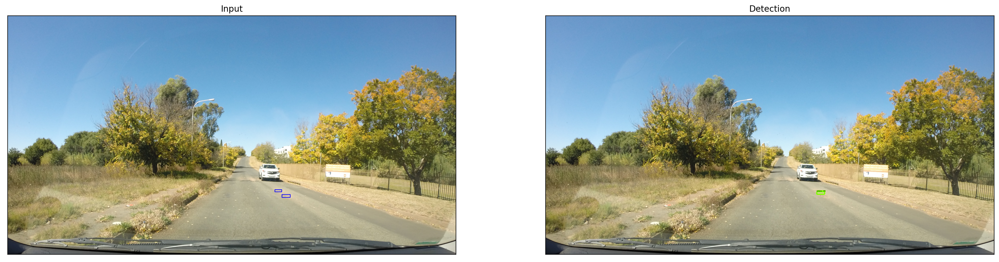

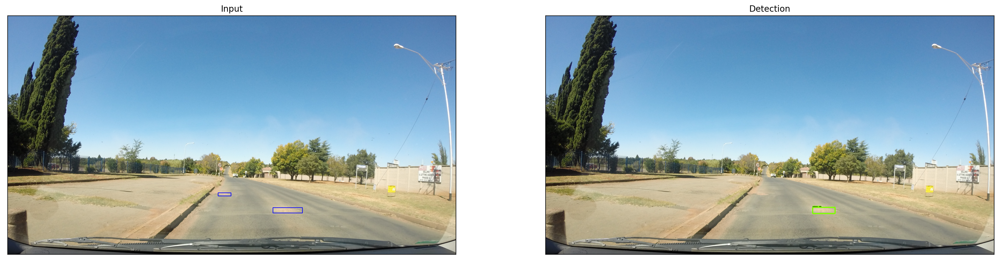

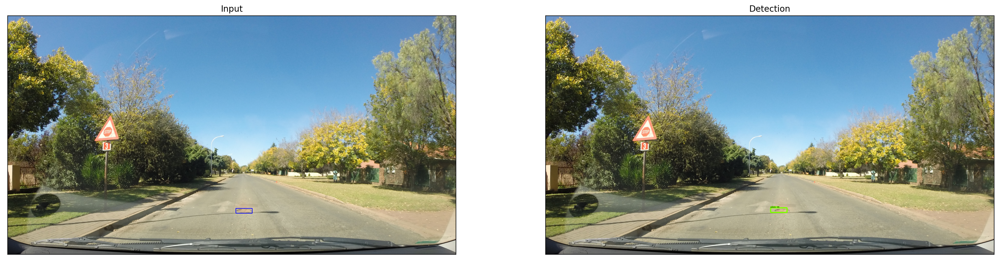

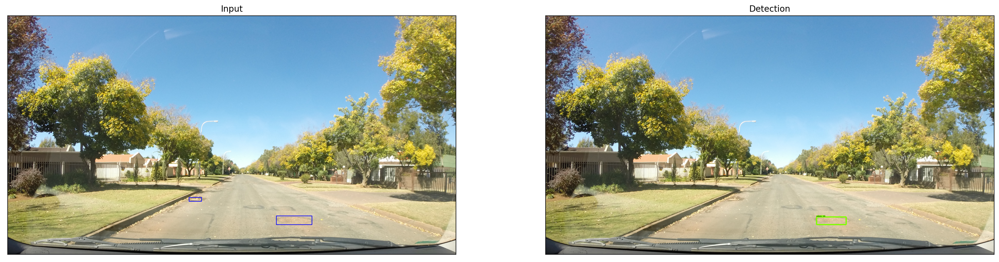

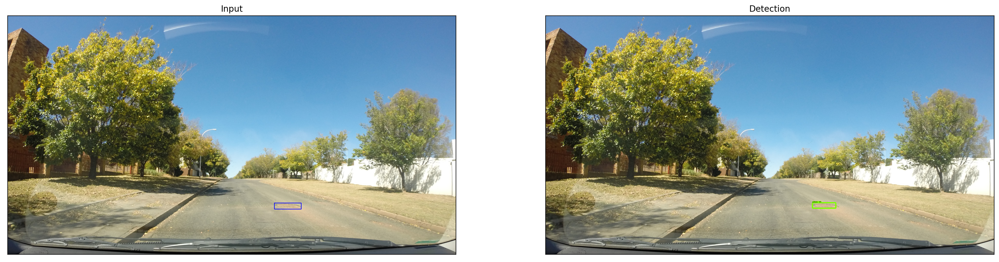

In [61]:
# Reference: https://towardsdatascience.com/object-detection-by-tensorflow-1-x-5a8cb72c1c4b
import cv2
from google.colab.patches import cv2_imshow
%cd /content/gdrive/MyDrive/pothole/models/research/object_detection

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops


# This is needed to display the images.
%matplotlib inline


from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

num_classes = 3

detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')


label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True)
category_index = label_map_util.create_category_index(categories)


def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

# Size, in inches, of the output images.
IMAGE_SIZE = (25, 30)
color = np.array([98])

def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session() as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(
                output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
                'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict


for image_path in IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        # track_ids=color,
        use_normalized_coordinates=True,
        line_thickness=10)
    
    plt.figure(figsize=IMAGE_SIZE, dpi=200)
    image_id = image_path.split('/')[-1]
    img = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    coords = img_bbox_df[img_bbox_df['image_id'] == image_id.split('.')[0]]
    coords = coords[['x', 'y', 'x_max', 'y_max']].values
    plt.subplot(1, 2, 1)
    plt.title('Input')
    plt.xticks([])
    plt.yticks([])
    # drawing BBoxes
    for c in coords:
        cv2.rectangle(img, (c[0], c[1]), 
                      (c[2], c[3]), (255, 0, 0), 3)

    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.subplot(1, 2, 2)
    plt.title('Detection')
    plt.xticks([])
    plt.yticks([])
    plt.imshow(image_np)
  

### Summary


* Obtained minimum loss of 5.45
* Achieved map of 0.155 @ 0.5 IoU
* From the above plots we can see that model is able to detect potholes quite well. 
* It also missed potholes in case of multiple potholes in a single image. Also the bounding boxes drawn do not fit the potholes properly. 
* In case of MobileNet there is always trade-off between performance and model complexity.